# Goal

Read segmentation object mesh objects into tensor array. Save.

# Imports

In [1]:
import os

# Paths to (1) code (2) data
code_src    = "/gpfs/home/gologr01"
data_src    = "/gpfs/data/oermannlab/private_data/DeepPit"

# stored code
deepPit_src = f"{code_src}/DeepPit"
obelisk_src = f"{code_src}/OBELISK"

# stored data
label_src   = f"{data_src}/PitMRdata/samir_labels"
sample_src  = f"{data_src}/sample_other_dsets"

# save matched mr/segs
dsetmd_src   = f"{data_src}/saved_dset_metadata"

def rm_prefix(lst, prefix=sample_src, skip=1): return [lst[i][len(prefix)+1:] for i in range(0,len(lst),skip)]

print("Folders in label src (data w labels): ", end=""); print(*os.listdir(label_src), sep=", ")


Folders in label src (data w labels): PPMI_full, 50155-50212, PPMI_3107-3326, ADNI1_full, 50313-50372, 50213-50312, 50373-50453, 50002-50153, ABVIB_full, AIBL_2-263, ICMB_1005-1297, ICMB_full, ADNI1_002_0023, AIBL_full, ABVIB_49_235


In [2]:
# # PATHS

# # CODE (DeepPit, OBELISK, etc)
# code_src     = "/workspace"
# deepPit_src  = f"{code_src}/DeepPit"
# obelisk_src  = f"{code_src}/OBELISK"

# # DATA (training, ABIDE, etc)
# todd_data_src = "../../../../..//media/labcomputer/e33f6fe0-5ede-4be4-b1f2-5168b7903c7a/home/rachel/"
# olab_data_src = "/gpfs/data/oermannlab/private_data/DeepPit/"
# docker_data_src = "../PitMRdata/Labels/ABIDE"

# curr_data_src = docker_data_src

# def change_src(fn, old_prefix=docker_data_src, new_prefix=olab_data_src):
#     return new_prefix + fn[len(old_prefix):]

# # path to training data
# train_src = curr_data_src

In [3]:
folders = ["PPMI_full", "ICMB_full", "ADNI1_full", "AIBL_full", "ABVIB_full"]

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import os, sys, time, pickle, re, glob, pprint

# imports
import SimpleITK as sitk
import torch
import numpy as np
import meshio
from pathlib     import Path
from collections import defaultdict

from helpers.preprocess import seg2mask, get_data_dict
from helpers.general    import sitk2np, lrange
from helpers.preprocess import mask2bbox
from helpers.viz        import viz_axis

from helpers.dset_info import (
    get_terminal_folders, 
    read_metadata_files, 
    get_unique_df, 
    get_iso_szs, 
    get_range, 
    print_unique, 
    get_ext
)

# Segm data

In [6]:
tot_len = 0
for folder in folders:
    print(f"{folder}: ", len(os.listdir(f"{label_src}/{folder}")))
    tot_len += len(os.listdir(f"{label_src}/{folder}"))
print(tot_len)

PPMI_full:  95
ICMB_full:  52
ADNI1_full:  90
AIBL_full:  89
ABVIB_full:  92
418


In [7]:
seg_terminal_folders = []
for folder in folders:
    seg_terminal_folders += get_terminal_folders(f"{label_src}/{folder}")
    
print(*[seg_terminal_folders[i] for i in range(0,100,20)], sep="\n")

/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/4029
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/4010
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/3372
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/3822
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/3369


In [8]:
# info
print(f"Len terminal folders: {len(seg_terminal_folders)}")

Len terminal folders: 418


# Match to MRs via {dset_name}/{folder} (eg AIBL/263)

In [9]:
dsets_src    = f"{data_src}/PitMRdata"

# key,val = dset_name, path to top level dir
dset_dict = {
    "ABIDE"                  : f"{dsets_src}/ABIDE",
    "ABVIB"                  : f"{dsets_src}/ABVIB/ABVIB",
    "ADNI1_Complete_1Yr_1.5T": f"{dsets_src}/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI",
    "AIBL"                   : f"{dsets_src}/AIBL/AIBL",
    "ICMB"                   : f"{dsets_src}/ICMB/ICBM",
    "PPMI"                   : f"{dsets_src}/PPMI/PPMI",
}

In [10]:
fn = seg_terminal_folders[0]
seg_dset_folder = fn[len(label_src)+1:]
seg_dset, seg_folder = seg_dset_folder.split("/")
print("Dset+folder: ", seg_dset_folder, ", Dset: ", seg_dset, ", Folder: ", seg_folder)

Dset+folder:  PPMI_full/4029 , Dset:  PPMI_full , Folder:  4029


In [11]:
def get_dset_folder(fn):
    seg_dset_folder = fn[len(label_src)+1:]
    seg_dset, seg_folder = seg_dset_folder.split("/")[:2] # first 2
    
    if seg_dset.startswith("ADNI"):
        dset_src = dset_dict["ADNI1_Complete_1Yr_1.5T"]
        return f"{dset_src}/{seg_folder}"
        
    for dset_name, dset_src in dset_dict.items():
        if seg_dset.startswith(dset_name):
            return f"{dset_src}/{seg_folder}"
    
    # combine with sampled 
    print("Missing: ", fn)
        

In [12]:
start = time.time()

seg_folders_orig_src = [get_dset_folder(fn) for fn in seg_terminal_folders]

elapsed = time.time() - start
print(f"ELapsed: {elapsed:.2f} s for {len(seg_terminal_folders)} folders.")

ELapsed: 0.00 s for 418 folders.


In [13]:
print(*[seg_folders_orig_src[i] for i in range(0,tot_len,20)], sep="\n")

/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4029
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4010
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3372
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3822
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3369
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ICMB/ICBM/UCLA_1498
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ICMB/ICBM/UTHC_1091
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ICMB/ICBM/UTHC_2009
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/041_S_1368
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/137_S_0800
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/033_S_0906
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/099_S_0291
/gpfs/data/oermannlab/private_data/DeepPit/PitMRd

# Get MR path from sampled

In [14]:
save_loc    = f"{data_src}/sample_other_dsets"
sampled_fnames = []

start = time.time()

for dset_name in dset_dict.keys():
    fnames = get_terminal_folders(f"{save_loc}/{dset_name}")
    sampled_fnames += fnames
    
elapsed = time.time() - start
print(f"Elaped {elapsed:.2f} s for {len(sampled_fnames)} fnames")

Elaped 6.83 s for 600 fnames


In [15]:
print(*[sampled_fnames[i][len(save_loc)+1:] for i in range(0,600,50)], sep="\n")

ABIDE/ABIDE_1/50263/MP-RAGE/2000-01-01_00_00_00.0/S166098
ABIDE/ABIDE/51074/MP-RAGE/2000-01-01_00_00_00.0/S164527
ABVIB/7036/T1_SPGR/2011-08-10_12_32_48.0/S354724
ABVIB/3375/MPRAGE/2011-01-05_15_24_54.0/S340812
ADNI1_Complete_1Yr_1.5T/029_S_1215/MPR__GradWarp__B1_Correction__N3__Scaled/2007-09-04_10_14_52.0/S38887
ADNI1_Complete_1Yr_1.5T/037_S_0627/MPR__GradWarp__N3__Scaled/2007-09-04_14_07_01.0/S38783
AIBL/263/MPRAGE_ADNI_confirmed/2009-11-20_09_25_07.0/S91498
AIBL/420/MPRAGE_SAG_ISO_p2/2014-06-21_11_27_47.0/S754489
ICMB/UTHC_1098/MPRAGE_T1_AX_0.8_mm_TI-780/2009-03-13_13_01_09.0/S68959
ICMB/UCLA_1296/SAG_MPRAGE_8_CHANNEL/2006-02-27_16_01_52.0/S16643
PPMI/4029/MPRAGE_GRAPPA/2016-10-18_14_14_19.0/S606273
PPMI/3373/MPRAGE_GRAPPA/2013-08-01_08_55_36.0/S199146


# Get top folder from sampled fnames

In [16]:
def get_sampled_stem(fn):
    
    for dset in dset_dict.keys():
        try:
            # get child folder
            idx = fn.rindex(dset)
            return re.search("(.*?\/.*?\/)", fn[idx:]).groups(0)[0]
        except:
            pass
    # ADNI instead of "ADNI1_Complete_1Yr_1.5T"
    try:
        idx = fn.rindex("ADNI")
        return re.search("(.*?\/.*?\/)", fn[idx:]).groups(0)[0]
    except:
        pass

In [17]:
# old_stems = []
# old_sampled_first = []
# for idx,sampled_fn in enumerate(sampled_fnames):
#     stem = get_sampled_stem(sampled_fn)
#     if stem not in old_stems:
#         old_stems.append(stem)
#         old_sampled_first.append(sampled_fn)

In [18]:
# print(new[5])
# os.listdir(new[5])

In [19]:
# new = [fn for fn in sampled_first if fn not in old_sampled_first]
# print(len(new), *rm_prefix(new, sample_src), sep="\n")

In [20]:
# print(*sorted(rm_prefix(missing_las, sample_src)), sep="\n")

In [21]:
stems_dict    = defaultdict(list)
for idx,sampled_fn in enumerate(sampled_fnames):
    stem = get_sampled_stem(sampled_fn)
    stems_dict[stem].append(sampled_fn)
        
stems = stems_dict.keys()

In [22]:
stems_dict[get_sampled_stem("ADNI1_Complete_1Yr_1.5T/007_S_0041/MPR__GradWarp__B1_Correction__N3__Scaled_2/2005-10-21_09_06_32.0/S9994")]

['/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/007_S_0041/MPR__GradWarp__B1_Correction__N3__Scaled_2/2006-05-15_09_34_35.0/S14691',
 '/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/007_S_0041/MPR__GradWarp__B1_Correction__N3__Scaled_2/2005-10-21_09_06_32.0/S9994']

In [23]:
#MPR-R

for val in stems_dict.values():
    if len(val) > 1: # and any(["MPR-R" in fn for fn in val]):
        print(len(val)); print(*rm_prefix(sorted(val)), sep="\n"); print("*"*50)

2
ABVIB/263/MPRAGE/2011-11-15_11_26_09.0/S343566
ABVIB/263/MPRAGE_S2_DIS3D/2011-11-15_11_26_09.0/S343575
**************************************************
2
ABVIB/60008/MPRAGE/2010-05-12_13_50_01.0/S342247
ABVIB/60008/MPRAGE/2012-03-21_09_59_38.0/S342266
**************************************************
2
ABVIB/226/t1_mpr_sag-WS/2010-12-16_11_47_47.0/S349171
ABVIB/226/t1_mpr_sag-WS/2013-01-17_09_27_26.0/S349181
**************************************************
2
ABVIB/1439/MPRAGE/2009-06-26_10_52_41.0/S340038
ABVIB/1439/MPRAGE/2011-10-19_14_24_21.0/S340056
**************************************************
2
ABVIB/7027/T1_SPGR/2011-02-17_10_15_18.0/S354995
ABVIB/7027/T1_SPGR/2011-04-04_14_59_33.0/S350948
**************************************************
3
ABVIB/2954/MPRAGE/2009-10-07_15_21_43.0/S340735
ABVIB/2954/MPRAGE/2010-12-13_11_41_29.0/S340748
ABVIB/2954/MPRAGE/2013-02-15_13_40_58.0/S340743
**************************************************
2
ABVIB/7029/T1_SPGR/2011-02-17_11_

In [62]:
# sort -- exception is MPR-R vs MPR__ (should be first)
sampled_first = [
    sorted(val)[1] 
    if len(val) > 1 and "MPR__" in sorted(val)[1] and "MPR-R" in sorted(val)[0] 
    else sorted(val)[0]             
    for val in stems_dict.values()
]

In [79]:
for val in stems_dict.values():
    if len(val) > 1 and "MPR__" in sorted(val)[1] and "MPR-R" in sorted(val)[0]:
        print("hi")
        print(sorted(val)[1])

hi
/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665
hi
/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/033_S_0906/MPR__GradWarp__B1_Correction__N3__Scaled/2006-09-25_12_38_45.0/S19314
hi
/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/041_S_0446/MPR__GradWarp__B1_Correction__N3__Scaled/2007-06-04_12_28_58.0/S33006


In [64]:
for f in sampled_first:
    if "126_S_0605" in f:
        print(f)

/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665


In [65]:
# count = 0
# for key,val in stems_dict.items():
#     if len(val) > 1:
#         print(count)
#         print(key)
#         print(*[v[len(sample_src)+1:] for v in val], sep="\n")
#         count += 1

In [66]:
# count = 0
# for key,val in stems_dict.items():
#     if len(val) > 1:
#         #print(count)
#         #print(key)
#         val2 = sorted(val)
#         if val != val2:
#             print("*"*50, count, "*"*50, sep="\n")
#             print(key)
#             print(*[v[len(sample_src)+1:] for v in val], sep="\n")
#             print("Sorted")
#             print(*[v[len(sample_src)+1:] for v in val2], sep="\n")
#             count += 1
#         #print(*[v[len(sample_src)+1:] for v in val2], sep="\n")
#         #count += 1

In [67]:
for dset in dset_dict.keys():
    print(dset, 100-len([stem for stem in stems if stem.startswith(f"{dset}")]))

ABIDE 0
ABVIB 8
ADNI1_Complete_1Yr_1.5T 9
AIBL 10
ICMB 48
PPMI 5


In [68]:
sorted(os.listdir("/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/033_S_0906"))

['MPR-R__GradWarp__B1_Correction__N3__Scaled',
 'MPR__GradWarp__B1_Correction__N3__Scaled']

In [69]:
print(len(sampled_first))
print(*sorted(rm_prefix(sampled_first, prefix=save_loc, skip=1)), sep="\n")
#print(*[sampled_first[i][len(save_loc)+1:] for i in range(0,len(sampled_first),50)], sep="\n")

520
ABIDE/ABIDE/50455/MP-RAGE/2000-01-01_00_00_00.0/S165455
ABIDE/ABIDE/50459/MP-RAGE/2000-01-01_00_00_00.0/S165187
ABIDE/ABIDE/50461/MP-RAGE/2000-01-01_00_00_00.0/S165203
ABIDE/ABIDE/50483/MP-RAGE/2000-01-01_00_00_00.0/S164443
ABIDE/ABIDE/50489/MP-RAGE/2000-01-01_00_00_00.0/S164922
ABIDE/ABIDE/50492/MP-RAGE/2000-01-01_00_00_00.0/S165232
ABIDE/ABIDE/50511/MP-RAGE/2000-01-01_00_00_00.0/S164331
ABIDE/ABIDE/50553/MP-RAGE/2000-01-01_00_00_00.0/S164751
ABIDE/ABIDE/50555/MP-RAGE/2000-01-01_00_00_00.0/S164943
ABIDE/ABIDE/50614/MP-RAGE/2000-01-01_00_00_00.0/S164779
ABIDE/ABIDE/50626/MP-RAGE/2000-01-01_00_00_00.0/S164856
ABIDE/ABIDE/50656/MP-RAGE/2000-01-01_00_00_00.0/S164782
ABIDE/ABIDE/50693/MP-RAGE/2000-01-01_00_00_00.0/S165380
ABIDE/ABIDE/50699/MP-RAGE/2000-01-01_00_00_00.0/S165019
ABIDE/ABIDE/50725/MP-RAGE/2000-01-01_00_00_00.0/S165235
ABIDE/ABIDE/50751/MP-RAGE/2000-01-01_00_00_00.0/S164329
ABIDE/ABIDE/50773/MP-RAGE/2000-01-01_00_00_00.0/S164902
ABIDE/ABIDE/50778/MP-RAGE/2000-01-01_00_00_0

# Match seg to sampled fn to MR

In [80]:
# matched_segs[0]

In [81]:
from helpers.general import cut
def match_seg(seg_fn):
    # seg_fn = {dset_src}/{seg_folder}
    for dset_name, dset_src in dset_dict.items():
        if seg_fn.startswith(dset_src):
            # find sample_fn with same dset + folder
            seg_folder = f"/{seg_fn[len(dset_src)+1:]}/" # terminate eg /2/ vs /280/
            matches = [fn for fn in sampled_first if dset_name in fn and seg_folder in fn]
            assert(len(matches) == 1)
            #return matches[0]
            # convert match to orig src
            return dset_src+cut(matches[0], sample_src+dset_name)

In [82]:
# matched MRs to segs in orig_seg_src
matched_segs = [match_seg(fn) for fn in seg_folders_orig_src]

In [83]:
print(*sorted(rm_prefix(matched_segs, prefix=data_src, skip=1)), sep="\n")

PitMRdata/ABVIB/ABVIB/1017/T1_SPGR/2012-03-27_09_45_10.0/S349928
PitMRdata/ABVIB/ABVIB/1031/T1_SPGR/2011-06-23_12_07_27.0/S349934
PitMRdata/ABVIB/ABVIB/1060/T1_SPGR/2013-05-21_11_38_08.0/S350017
PitMRdata/ABVIB/ABVIB/1067/T1_SPGR/2013-05-14_14_49_05.0/S350054
PitMRdata/ABVIB/ABVIB/1112/T1_SPGR/2011-02-07_10_05_45.0/S350078
PitMRdata/ABVIB/ABVIB/113/t1_mpr_sag-WS/2009-06-30_09_38_19.0/S347072
PitMRdata/ABVIB/ABVIB/1133/T1_SPGR/2009-06-16_11_38_46.0/S350146
PitMRdata/ABVIB/ABVIB/1139/T1_SPGR/2013-05-03_11_43_22.0/S350205
PitMRdata/ABVIB/ABVIB/1187/T1_SPGR/2009-05-13_09_40_31.0/S350419
PitMRdata/ABVIB/ABVIB/1191/T1_SPGR/2011-06-21_14_50_30.0/S350460
PitMRdata/ABVIB/ABVIB/1284/MPRAGE/2012-04-03_10_13_00.0/S340021
PitMRdata/ABVIB/ABVIB/1393/MPRAGE/2013-02-08_13_10_33.0/S340026
PitMRdata/ABVIB/ABVIB/1439/MPRAGE/2009-06-26_10_52_41.0/S340038
PitMRdata/ABVIB/ABVIB/1448/T1_SPGR/2011-09-07_11_32_36.0/S350316
PitMRdata/ABVIB/ABVIB/145/t1_mpr_sag/2009-04-07_10_48_47.0/S347121
PitMRdata/ABVIB/ABVIB

In [84]:
print(len(matched_segs), len(sampled_first))
print(*sorted(rm_prefix(sampled_first, skip=1)), sep="\n")

418 520
ABIDE/ABIDE/50455/MP-RAGE/2000-01-01_00_00_00.0/S165455
ABIDE/ABIDE/50459/MP-RAGE/2000-01-01_00_00_00.0/S165187
ABIDE/ABIDE/50461/MP-RAGE/2000-01-01_00_00_00.0/S165203
ABIDE/ABIDE/50483/MP-RAGE/2000-01-01_00_00_00.0/S164443
ABIDE/ABIDE/50489/MP-RAGE/2000-01-01_00_00_00.0/S164922
ABIDE/ABIDE/50492/MP-RAGE/2000-01-01_00_00_00.0/S165232
ABIDE/ABIDE/50511/MP-RAGE/2000-01-01_00_00_00.0/S164331
ABIDE/ABIDE/50553/MP-RAGE/2000-01-01_00_00_00.0/S164751
ABIDE/ABIDE/50555/MP-RAGE/2000-01-01_00_00_00.0/S164943
ABIDE/ABIDE/50614/MP-RAGE/2000-01-01_00_00_00.0/S164779
ABIDE/ABIDE/50626/MP-RAGE/2000-01-01_00_00_00.0/S164856
ABIDE/ABIDE/50656/MP-RAGE/2000-01-01_00_00_00.0/S164782
ABIDE/ABIDE/50693/MP-RAGE/2000-01-01_00_00_00.0/S165380
ABIDE/ABIDE/50699/MP-RAGE/2000-01-01_00_00_00.0/S165019
ABIDE/ABIDE/50725/MP-RAGE/2000-01-01_00_00_00.0/S165235
ABIDE/ABIDE/50751/MP-RAGE/2000-01-01_00_00_00.0/S164329
ABIDE/ABIDE/50773/MP-RAGE/2000-01-01_00_00_00.0/S164902
ABIDE/ABIDE/50778/MP-RAGE/2000-01-01_00_

In [85]:
# # Save sampled first
# dsetmd_src   = f"{data_src}/saved_dset_metadata"
# dset_name    = f"sample_other_dsets_{len(sampled_first)}_first"
# with open(f"{dsetmd_src}/{dset_name}_fnames.txt", "w") as f:
#     f.write('\n'.join(sampled_first))

In [86]:
matched_segs[0]

'/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4029/MPRAGE_GRAPPA/2016-10-18_14_14_19.0/S606273'

In [87]:
print('\n'.join([str(o) for o in zip(matched_segs, seg_terminal_folders)]))

('/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4029/MPRAGE_GRAPPA/2016-10-18_14_14_19.0/S606273', '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/4029')
('/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/40893/MPRAGE_GRAPPA_2/2018-03-26_12_25_06.0/S689720', '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40893')
('/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3852/MPRAGE_GRAPPA/2014-04-22_08_30_44.0/S228246', '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/3852')
('/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3126/Sag_MPRAGE_GRAPPA/2016-08-24_11_49_25.0/S510960', '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/3126')
('/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3173/MPRAGE_GRAPPA/2012-01-31_08_37_44.0/S142542', '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full

In [88]:
# Save matched segs
with open(f"{dsetmd_src}/first_{len(matched_segs)}_matched_segs.txt", "w") as f:
    f.write('\n'.join([str(o) for o in zip(matched_segs, seg_terminal_folders)]))

# Original

In [89]:
# how many not yet reoriented + N4 bias
import glob
missing_las      = []
missing_las_idxs = []

for idx, mr_path in enumerate(matched_segs):
    niis        = glob.glob(f"{mr_path}/*.nii", recursive=True)
    las_n4_niis = [nii for nii in niis if "las_n4" in nii or "las_corrected_n4" in nii]
    if len(las_n4_niis) == 0:
        missing_las.append(mr_path)
        missing_las_idxs.append(idx)
    else:
        assert(len(las_n4_niis)==1 or len(las_n4_niis) == 2)
    assert (len(niis) >= 1)

print("Missing las n4: ", len(missing_las))

Missing las n4:  0


# Process

In [90]:
matched_segs[0]

'/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4029/MPRAGE_GRAPPA/2016-10-18_14_14_19.0/S606273'

In [91]:
from helpers.general import cut
def match_seg2(seg_fn):
    # seg_fn = {dset_src}/{seg_folder}
    for dset_name, dset_src in dset_dict.items():
        if seg_fn.startswith(dset_src):
            # find sample_fn with same dset + folder
            seg_folder = f"/{seg_fn[len(dset_src)+1:]}/" # terminate eg /2/ vs /280/
            matches = [fn for fn in sampled_first if dset_name in fn and seg_folder in fn]
            assert(len(matches) == 1)
            return matches[0]
            # convert match to orig src
            #return dset_src+cut(matches[0], sample_src+dset_name)

# matched MRs to segs in orig_seg_src
matched_segs_sample_src = [match_seg2(fn) for fn in seg_folders_orig_src]

In [92]:
for idx, mr_path in enumerate(matched_segs): #_sample_src
    niis        = glob.glob(f"{mr_path}/*corrected_n4.nii", recursive=True)
    if len(niis) == 0:
        w = glob.glob(f"{mr_path}/*.nii", recursive=True)
        print(*[Path(x).name for x in w], sep="\n")

In [93]:
unique_niis = {}
all_others = set()
for idx, mr_path in enumerate(matched_segs): # matched_segs_sample_src
    niis        = glob.glob(f"{mr_path}/*.nii", recursive=True)
    if len(niis) > 0:
        others = [nii for nii in niis if "las" in nii or "corrected" in nii or "n4" in nii]
        
        # remove prefix
        others = [Path(x).name for x in others]
        if len(others) == len(niis):
            print(*[Path(x).name for x in niis])
        assert len(others) == len(niis) or len(others) + 1 == len(niis)
        unique_niis[idx] = others
        all_others.update(set(others))

las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_correcte

las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_corrected_n4.nii corrected_n4.nii
las_correcte

In [94]:
all_others

{'corrected_n4.nii', 'las_corrected_n4.nii'}

In [95]:
# how many not yet reoriented + N4 bias
import glob
missing_las      = []
missing_las_idxs = []

for idx, mr_path in enumerate(matched_segs_sample_src):
    niis        = glob.glob(f"{mr_path}/*.nii", recursive=True)
    las_niis = [nii for nii in niis if "las" in nii]
    if len(las_niis) == 0:
        missing_las.append(mr_path)
        missing_las_idxs.append(idx)
    else:
        pass
        #assert(len(las_n4_niis)==1 or len(las_n4_niis) == 2)
    #assert (len(niis) >= 1)

In [96]:
ml_idx = -2
true_idx = missing_las_idxs[ml_idx]
print(missing_las[ml_idx])
print(matched_segs_sample_src[true_idx])
print(matched_segs[true_idx])

/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ABVIB/61035/MPRAGE/2011-12-14_10_29_23.0/S342449
/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ABVIB/61035/MPRAGE/2011-12-14_10_29_23.0/S342449
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ABVIB/ABVIB/61035/MPRAGE/2011-12-14_10_29_23.0/S342449


In [97]:
print("Missing las: ", len(missing_las))

Missing las:  307


In [79]:
# all have .nii, most but not all have corrected_n4
for mr_path in missing_las:
    #print(rm_prefix(glob.glob(f"{mr_path}/*.nii")))
    l = len(glob.glob(f"{mr_path}/*corrected_n4.nii"))
    if l == 0:
        #print(mr_path)
        nii = glob.glob(f"{mr_path}/*.nii")
        print(len(nii),*nii,sep="\n\n"); print("*"*50)

1

/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/033_S_0906/MPR-R__GradWarp__B1_Correction__N3__Scaled/2007-04-26_18_01_03.0/S30931/ADNI_033_S_0906_MR_MPR-R__GradWarp__B1_Correction__N3__Scaled_Br_20070809192351371_S30931_I66569.nii
**************************************************
1

/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/128_S_1088/MPR-R__GradWarp__B1_Correction__N3__Scaled/2006-12-07_16_00_06.0/S23787/ADNI_128_S_1088_MR_MPR-R__GradWarp__B1_Correction__N3__Scaled_Br_20070819184202735_S23787_I69104.nii
**************************************************
1

/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/133_S_0771/MPR-R__GradWarp__B1_Correction__N3__Scaled/2007-10-11_15_33_40.0/S41411/ADNI_133_S_0771_MR_MPR-R__GradWarp__B1_Correction__N3__Scaled_Br_20080220161456133_S41411_I91189.nii
**************************************************
1

/gpfs/data/oermannlab/pri

In [80]:
print(len(missing_las))
sorted(rm_prefix(missing_las))

307


['ABVIB/1031/T1_SPGR/2011-06-23_12_07_27.0/S349934',
 'ABVIB/1060/T1_SPGR/2013-05-21_11_38_08.0/S350017',
 'ABVIB/1067/T1_SPGR/2013-05-14_14_49_05.0/S350054',
 'ABVIB/1112/T1_SPGR/2011-02-07_10_05_45.0/S350078',
 'ABVIB/1133/T1_SPGR/2009-06-16_11_38_46.0/S350146',
 'ABVIB/1139/T1_SPGR/2013-05-03_11_43_22.0/S350205',
 'ABVIB/1187/T1_SPGR/2009-05-13_09_40_31.0/S350419',
 'ABVIB/1191/T1_SPGR/2011-06-21_14_50_30.0/S350460',
 'ABVIB/1284/MPRAGE/2012-04-03_10_13_00.0/S340021',
 'ABVIB/1393/MPRAGE/2013-02-08_13_10_33.0/S340026',
 'ABVIB/1439/MPRAGE/2009-06-26_10_52_41.0/S340038',
 'ABVIB/1448/T1_SPGR/2011-09-07_11_32_36.0/S350316',
 'ABVIB/1759/MPRAGE/2009-08-10_10_20_14.0/S340117',
 'ABVIB/20107/MPRAGE/2012-02-28_11_14_19.0/S342038',
 'ABVIB/240/MPRAGE/2011-07-15_12_04_00.0/S343389',
 'ABVIB/241/MPRAGE/2011-05-24_15_25_55.0/S343403',
 'ABVIB/2469/MPRAGE/2011-03-15_11_19_51.0/S340169',
 'ABVIB/254/MPRAGE/2011-09-08_12_00_52.0/S343491',
 'ABVIB/257/MPRAGE/2011-10-13_14_13_49.0/S343538',
 'ABVI

In [110]:
f = "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385560/Segmentation.obj"

In [137]:
for f in (
    "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385560", 
    "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/T1_repeat/2017-11-16_15_16_58.0/S787810"):
    print("hi")
    new_f = f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(f, label_src)).groups(0)[0]
    print(new_f)
    print(os.listdir(f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(f, label_src)).groups(0)[0]))

hi
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289
['Segmentation.obj', 'MPRAGE_GRAPPA_ADNI', 'Segmentation.mtl']
hi
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740
['Segmentation.obj', 'Segmentation.mtl', 'T1_repeat']


In [127]:
for idx, mr_path in enumerate(matched_segs):
    seg_path  = seg_terminal_folders[idx]
    if not os.path.isfile(f"{seg_path}/Segmentation.obj"):
        print(seg_path)

/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385560
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/T1_repeat/2017-11-16_15_16_58.0/S787810


In [130]:
os.listdir("/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/")
os.listdir("/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289")

['Segmentation.obj', 'MPRAGE_GRAPPA_ADNI', 'Segmentation.mtl']

In [162]:
# from shutil import copyfile
# dest = "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/T1_repeat/2017-11-16_15_16_58.0/S787810"
# src  = "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/"

# #src += "/seg.pt"
# #dest += "/seg.pt"
# print(os.path.isfile(src + "/Segmentation.obj"))
# print(os.path.isfile(src + "/seg.pt"))
# print(os.path.isfile(dest + "/seg.pt"))

# if os.path.isfile(dest + "/seg.pt"):
#     os.remove(dest+"/seg.pt")
    
# copyfile(src+"/seg.pt", dest+"/seg.pt")

True
True
False


'/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740/T1_repeat/2017-11-16_15_16_58.0/S787810/seg.pt'

In [160]:
for idx, mr_path in enumerate(matched_segs):
    
    # skip if already done
    seg_path  = seg_terminal_folders[idx]
        
    # find new path if no seg obj (PPMI_full/41289 vs PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385)
    if not os.path.isfile(f"{seg_path}/Segmentation.obj"):
        seg_path = f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(seg_path, label_src)).groups(0)[0]
        print(seg_path)

/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/41289
/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_full/40740


In [101]:
todo_stems = [
    "/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665",
    "/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/033_S_0906/MPR__GradWarp__B1_Correction__N3__Scaled/2006-09-25_12_38_45.0/S19314",
    "/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/041_S_0446/MPR__GradWarp__B1_Correction__N3__Scaled/2007-06-04_12_28_58.0/S33006"
]

In [108]:
matched_segs

['/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4029/MPRAGE_GRAPPA/2016-10-18_14_14_19.0/S606273',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/40893/MPRAGE_GRAPPA_2/2018-03-26_12_25_06.0/S689720',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3852/MPRAGE_GRAPPA/2014-04-22_08_30_44.0/S228246',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3126/Sag_MPRAGE_GRAPPA/2016-08-24_11_49_25.0/S510960',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3173/MPRAGE_GRAPPA/2012-01-31_08_37_44.0/S142542',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/4001/MPRAGE_GRAPPA/2011-07-08_11_00_21.0/S135598',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3806/MPRAGE_GRAPPA/2012-07-31_10_38_12.0/S171204',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3627/SAG_T1_3D_MPRAGE/2012-05-22_14_55_52.0/S178125',
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PP

In [114]:
# 163, 200, 204
print(matched_segs[163])
print(todo_stems[0])

/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665
/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665


False

In [116]:
# do reorient + n4 bias

new_ori = "LAS"

# BEGIN LOOP
for idx, mr_path in zip([163,200,204],[matched_segs[i] for i in [163,200,204]]):
      
    # find new path if no seg obj (PPMI_full/41289 vs PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385)
    seg_path  = seg_terminal_folders[idx]
    if not os.path.isfile(f"{seg_path}/Segmentation.obj"):
        seg_path = f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(seg_path, label_src)).groups(0)[0]
        
    start = time.time()
    
    # get mr_path
    mr_path = glob.glob(f"{mr_path}/*corrected_n4.nii")[0]
    
    # load mr_path to sitk
    mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    
    # load seg_path to mk tensor
    mk        = meshio.read(f"{seg_path}/Segmentation.obj")
    mk        = seg2mask(mr, mk, ras_adj=False)    
    mk        = torch.tensor(mk).long()
    
    # mk tensor to sitk
    mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
    mk.SetDirection(mr.GetDirection())
    
    # reorient
    #mr = sitk.DICOMOrient(mr, new_ori)
    mk = sitk.DICOMOrient(mk, new_ori)

    # save reoriented mk
    mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
    torch.save(mk_arr, f"{seg_path}/seg.pt")
    
#     if not mr_path.endswith("corrected_n4.nii"):
#         # N4 bias: Mask the head to estimate bias
#         print("N4 bias")
#         maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

#         # Set corrector
#         corrector = sitk.N4BiasFieldCorrectionImageFilter()
#         corrector.SetMaximumNumberOfIterations([3] * 3)
#         corrected_image = corrector.Execute(mr, maskImage)

#     else:
#         corrected_image = mr
        
#     # write image
#     corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
#     sitk.WriteImage(corrected_image, corrected_fn)
        
    
    elapsed = time.time() - start
    print(f"{idx}. Elapsed: {elapsed:.2f} s")

163. Elapsed: 1.90 s
200. Elapsed: 1.80 s
204. Elapsed: 1.38 s


In [159]:
# do reorient + n4 bias

new_ori = "LAS"

# BEGIN LOOP
for idx, mr_path in enumerate(matched_segs):
      
    # find new path if no seg obj (PPMI_full/41289 vs PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385)
    seg_path  = seg_terminal_folders[idx]
    if not os.path.isfile(f"{seg_path}/Segmentation.obj"):
        seg_path = f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(seg_path, label_src)).groups(0)[0]
    
    else:
        continue
        
    start = time.time()
    
    # get mr_path
    mr_path = glob.glob(f"{mr_path}/*corrected_n4.nii")[0]
    
    # load mr_path to sitk
    mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    
    # load seg_path to mk tensor
    mk        = meshio.read(f"{seg_path}/Segmentation.obj")
    mk        = seg2mask(mr, mk, ras_adj=False)    
    mk        = torch.tensor(mk).long()
    
    # mk tensor to sitk
    mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
    mk.SetDirection(mr.GetDirection())
    
    # reorient
    #mr = sitk.DICOMOrient(mr, new_ori)
    mk = sitk.DICOMOrient(mk, new_ori)

    # save reoriented mk
    mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
    torch.save(mk_arr, f"{seg_path}/seg.pt")
    
#     if not mr_path.endswith("corrected_n4.nii"):
#         # N4 bias: Mask the head to estimate bias
#         print("N4 bias")
#         maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

#         # Set corrector
#         corrector = sitk.N4BiasFieldCorrectionImageFilter()
#         corrector.SetMaximumNumberOfIterations([3] * 3)
#         corrected_image = corrector.Execute(mr, maskImage)

#     else:
#         corrected_image = mr
        
#     # write image
#     corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
#     sitk.WriteImage(corrected_image, corrected_fn)
        
    
    elapsed = time.time() - start
    print(f"{idx}. Elapsed: {elapsed:.2f} s")

68. Elapsed: 1.78 s
91. Elapsed: 2.04 s


In [138]:
# do reorient + n4 bias

new_ori = "LAS"

# BEGIN LOOP
for idx, mr_path in enumerate(matched_segs):
    
    # skip if already done
    seg_path  = seg_terminal_folders[idx]
    if os.path.isfile(f"{seg_path}/seg.pt"): continue
        
    # find new path if no seg obj (PPMI_full/41289 vs PPMI_full/41289/MPRAGE_GRAPPA_ADNI/2015-12-01_13_13_37.0/S385)
    if not os.path.isfile(f"{seg_path}/Segmentation.obj"):
        seg_path = f"{label_src}/" + re.search("(.*?\/.*?)\/", cut(f, label_src)).groups(0)[0]
            
    start = time.time()
    
    # get mr_path
    mr_path = glob.glob(f"{mr_path}/*corrected_n4.nii")[0]
    
    # load mr_path to sitk
    mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    
    # load seg_path to mk tensor
    mk        = meshio.read(f"{seg_path}/Segmentation.obj")
    mk        = seg2mask(mr, mk, ras_adj=False)    
    mk        = torch.tensor(mk).long()
    
    # mk tensor to sitk
    mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
    mk.SetDirection(mr.GetDirection())
    
    # reorient
    #mr = sitk.DICOMOrient(mr, new_ori)
    mk = sitk.DICOMOrient(mk, new_ori)

    # save reoriented mk
    mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
    torch.save(mk_arr, f"{seg_path}/seg.pt")
    
#     if not mr_path.endswith("corrected_n4.nii"):
#         # N4 bias: Mask the head to estimate bias
#         print("N4 bias")
#         maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

#         # Set corrector
#         corrector = sitk.N4BiasFieldCorrectionImageFilter()
#         corrector.SetMaximumNumberOfIterations([3] * 3)
#         corrected_image = corrector.Execute(mr, maskImage)

#     else:
#         corrected_image = mr
        
#     # write image
#     corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
#     sitk.WriteImage(corrected_image, corrected_fn)
        
    
    elapsed = time.time() - start
    print(f"{idx}. Elapsed: {elapsed:.2f} s")

68. Elapsed: 1.82 s
69. Elapsed: 1.94 s
70. Elapsed: 2.00 s
71. Elapsed: 1.85 s
72. Elapsed: 1.94 s
73. Elapsed: 1.93 s
74. Elapsed: 1.77 s
75. Elapsed: 1.88 s
76. Elapsed: 1.96 s
77. Elapsed: 1.87 s
78. Elapsed: 1.24 s
79. Elapsed: 2.20 s
80. Elapsed: 1.97 s
81. Elapsed: 1.95 s
82. Elapsed: 1.23 s
83. Elapsed: 2.03 s
84. Elapsed: 1.84 s
85. Elapsed: 2.98 s
86. Elapsed: 1.81 s
87. Elapsed: 1.82 s
88. Elapsed: 2.03 s
89. Elapsed: 3.04 s
90. Elapsed: 1.83 s
91. Elapsed: 2.08 s
92. Elapsed: 1.96 s
93. Elapsed: 2.46 s
94. Elapsed: 1.87 s
95. Elapsed: 1.99 s
96. Elapsed: 1.67 s
97. Elapsed: 2.12 s
98. Elapsed: 1.67 s
99. Elapsed: 2.15 s
100. Elapsed: 1.83 s
101. Elapsed: 1.80 s
102. Elapsed: 2.23 s
103. Elapsed: 2.12 s
104. Elapsed: 1.75 s
105. Elapsed: 1.76 s
106. Elapsed: 2.18 s
107. Elapsed: 1.98 s
108. Elapsed: 1.71 s
109. Elapsed: 2.15 s
110. Elapsed: 1.99 s
111. Elapsed: 1.74 s
112. Elapsed: 2.10 s
113. Elapsed: 1.97 s
114. Elapsed: 1.96 s
115. Elapsed: 1.95 s
116. Elapsed: 1.67 s
117

In [23]:
# how many have nii/corrected nii
# save_niis = [glob.glob(f"{mr_path}/*las_no_n4.nii")[0] for mr_path in matched_segs]

In [100]:
save_niis = [mr_path for mr_path in matched_segs if len(glob.glob(f"{mr_path}/*las_no_n4.nii")) == 0]

In [101]:
len(save_niis)

10

In [54]:
# # # how many have nii/corrected nii
# import glob
# save_niis = []

# for mr_path in matched_segs:
#     niis = glob.glob(f"{mr_path}/*.nii", recursive=True)
#     uncorrected = [nii for nii in niis if not nii.endswith("corrected_n4.nii")]
#     if len(uncorrected) == 1:
#         save_niis.append(uncorrected[0])
#     else:
#         uncorrected = [nii for nii in niis if not nii.endswith("las_corrected_n4.nii")]
#         save_niis.append(uncorrected[0])

In [103]:
print(len(save_niis))
print(*[f[-20:] for f in save_niis], sep="\n")

10
03_14_36_33.0/S63850
27_10_10_43.0/S16256
13_10_45_31.0/S16114
07_09_07_59.0/S16661
06_15_40_36.0/S16534
01_14_49_28.0/S16214
06_16_53_11.0/S16469
15_11_30_13.0/S16713
-21_09_06_32.0/S9994
6_11_47_47.0/S349171


In [26]:
matched_segs[0]

'/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/AIBL/263/MPRAGE_ADNI_confirmed/2009-11-20_09_25_07.0/S91498'

In [109]:
missing_las[5], missing_las_idxs[5], seg_terminal_folders[missing_las_idxs[5]]

('/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ICMB/UCLA_1098/SAG_MPRAGE_8_CHANNEL/2005-12-01_14_49_28.0/S16214',
 31,
 '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/ICMB_1005-1297/UCLA_1098')

In [58]:
# one_off_mr_path  = "/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/ADNI1_Complete_1Yr_1.5T/007_S_0041/MPR__GradWarp__B1_Correction__N3__Scaled_2/2005-10-21_09_06_32.0/S9994"
# one_off_seg_path = "/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/ADNI1_002_0023/007_S_0041"

In [61]:
# one_off_mr_path  = '/gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/PPMI/3125/Sag_MPRAGE_GRAPPA/2014-07-16_09_59_29.0/S228121/las_n4.nii'
# one_off_seg_path = '/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_3107-3326/3125'

In [55]:
# os.listdir(one_off_seg_path)

['Segmentation.obj', 'seg.pt', 'Segmentation.mtl']

In [62]:
# # ONE-OFF REDO

# new_ori = "LAS"

# start = time.time()

# # CAREFUL CAREFUL HERE
# # get mr_path
# #mr_path = glob.glob(f"{one_off_mr_path}/*.nii")[0]

# mr_path = one_off_mr_path
# seg_path = f"{one_off_seg_path}/Segmentation.obj"
# print(f"MR", mr_path)
# print(f"MK", seg_path)

# # load mr_path to sitk
# mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)

# # load seg_path to mk tensor
# mk        = meshio.read(seg_path)
# mk        = seg2mask(mr, mk, ras_adj=False)    
# mk        = torch.tensor(mk).long()

# # mk tensor to sitk
# mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
# mk.SetDirection(mr.GetDirection())

# # reorient
# mr = sitk.DICOMOrient(mr, new_ori)
# mk = sitk.DICOMOrient(mk, new_ori)

# # save reoriented mk
# mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
# torch.save(mk_arr, f"{one_off_seg_path}/seg.pt")

# if not mr_path.endswith("corrected_n4.nii") or not mr_path.endswith("las_n4.nii"):
#     # N4 bias: Mask the head to estimate bias
#     print("N4 bias")
#     maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

#     # Set corrector
#     corrector = sitk.N4BiasFieldCorrectionImageFilter()
#     corrector.SetMaximumNumberOfIterations([3] * 3)
#     corrected_image = corrector.Execute(mr, maskImage)

# else:
#     corrected_image = mr

# # write image
# corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
# sitk.WriteImage(corrected_image, corrected_fn)


# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:.2f} s")

MR /gpfs/data/oermannlab/private_data/DeepPit/sample_other_dsets/PPMI/3125/Sag_MPRAGE_GRAPPA/2014-07-16_09_59_29.0/S228121/las_n4.nii
MK /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_3107-3326/3125/Segmentation.obj
N4 bias
Elapsed: 33.53 s


In [52]:
seg_path

'/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/PPMI_3107-3326/3125'

In [51]:
missing_las_idxs

NameError: name 'missing_las_idxs' is not defined

In [ ]:
# # do reorient + n4 bias

# new_ori = "LAS"

# mr_path  = one_off_mr_path
# seg_path = one_off_seg_path

# start = time.time()

# # get mr_path
# mr_path = glob.glob(f"{mr_path}/*.nii")[0]

# # load mr_path to sitk
# mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)

# # load seg_path to mk tensor
# seg_path  = seg_terminal_folders[idx]
# mk        = meshio.read(f"{seg_path}/Segmentation.obj")
# mk        = seg2mask(mr, mk, ras_adj=False)    
# mk        = torch.tensor(mk).long()

# # mk tensor to sitk
# mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
# mk.SetDirection(mr.GetDirection())

# # reorient
# mr = sitk.DICOMOrient(mr, new_ori)
# mk = sitk.DICOMOrient(mk, new_ori)

# # save reoriented mk
# mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
# torch.save(mk_arr, f"{seg_path}/seg.pt")

# if not mr_path.endswith("corrected_n4.nii"):
#     # N4 bias: Mask the head to estimate bias
#     print("N4 bias")
#     maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

#     # Set corrector
#     corrector = sitk.N4BiasFieldCorrectionImageFilter()
#     corrector.SetMaximumNumberOfIterations([3] * 3)
#     corrected_image = corrector.Execute(mr, maskImage)

# else:
#     corrected_image = mr

# # write image
# corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
# sitk.WriteImage(corrected_image, corrected_fn)


# elapsed = time.time() - start
# print(f"{idx}. Elapsed: {elapsed:.2f} s")

In [124]:
# do reorient + n4 bias

new_ori = "LAS"

# BEGIN LOOP
for idx, mr_path in zip(missing_las_idxs, missing_las):
    start = time.time()
    
    # get mr_path
    mr_path = glob.glob(f"{mr_path}/*.nii")[0]
    
    # load mr_path to sitk
    mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    
    # load seg_path to mk tensor
    seg_path  = seg_terminal_folders[idx]
    mk        = meshio.read(f"{seg_path}/Segmentation.obj")
    mk        = seg2mask(mr, mk, ras_adj=False)    
    mk        = torch.tensor(mk).long()
    
    # mk tensor to sitk
    mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
    mk.SetDirection(mr.GetDirection())
    
    # reorient
    mr = sitk.DICOMOrient(mr, new_ori)
    mk = sitk.DICOMOrient(mk, new_ori)

    # save reoriented mk
    mk_arr = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).long()
    torch.save(mk_arr, f"{seg_path}/seg.pt")
    
    if not mr_path.endswith("corrected_n4.nii"):
        # N4 bias: Mask the head to estimate bias
        print("N4 bias")
        maskImage = sitk.OtsuThreshold(mr, 0, 1, 200)

        # Set corrector
        corrector = sitk.N4BiasFieldCorrectionImageFilter()
        corrector.SetMaximumNumberOfIterations([3] * 3)
        corrected_image = corrector.Execute(mr, maskImage)

    else:
        corrected_image = mr
        
    # write image
    corrected_fn = f"{Path(mr_path).parent}/las_n4.nii"
    sitk.WriteImage(corrected_image, corrected_fn)
        
    
    elapsed = time.time() - start
    print(f"{idx}. Elapsed: {elapsed:.2f} s")

9. Elapsed: 1.88 s
21. Elapsed: 2.25 s
25. Elapsed: 2.51 s
28. Elapsed: 2.37 s
30. Elapsed: 2.52 s
31. Elapsed: 2.58 s
34. Elapsed: 2.73 s
37. Elapsed: 2.76 s
N4 bias
50. Elapsed: 27.60 s
64. Elapsed: 2.26 s


In [ ]:
# # Mask the head to estimate bias
# maskImage = sitk.OtsuThreshold(inputImage, 0, 1, 200)

# # Set corrector
# corrector = sitk.N4BiasFieldCorrectionImageFilter()
# corrector.SetMaximumNumberOfIterations([3] * 3)
# corrected_image = corrector.Execute(inputImage, maskImage)

# # write image
# corrected_fn = f"{mr_path}/corrected_n4.nii"
# sitk.WriteImage(corrected_image, corrected_fn)

In [30]:
# # reorient & save seg arr

# # SET ORIENTATION
# new_ori = "LAS"

# # BEGIN LOOP
# for idx in range(len(save_niis)):
#     start = time.time()
    
#     mr_path   = save_niis[idx]
#     seg_path  = seg_terminal_folders[idx]
#     save_path = seg_path
        
#     # get sitk objs
#     mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
#     mk      = torch.load(f"{save_path}/seg.pt")
    
#     # reorient
#     mk = sitk.GetImageFromArray(torch.transpose(mk.float(), 0, 2))
#     mk.SetDirection(mr.GetDirection())
    
#     # reorient
#     im = sitk.DICOMOrient(mr, new_ori)
#     mk = sitk.DICOMOrient(mk, new_ori)

#     # to tensor
#     #im = torch.transpose(torch.tensor(sitk.GetArrayFromImage(im)), 0, 2)
#     mk = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).float()
 
#     # save
#     mk_arr = torch.tensor(mk).long()
#     torch.save(mk_arr, f"{save_path}/seg.pt")
    
#     # mr save
#     mr_folder = Path(mr_path).parent
#     sitk.WriteImage(im, f"{mr_folder}/las_no_n4.nii")
    
#     elapsed = time.time() - start
#     print(f"{idx}. Elapsed: {elapsed:.2f} s")

In [ ]:
# convert & save seg arr
for idx in range(len(save_niis)):
    start = time.time()
    
    mr_path   = save_niis[idx]
    seg_path  = seg_terminal_folders[idx]
    save_path = seg_path
        
    # get sitk objs
    mr      = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    mk      = meshio.read(f"{seg_path}/Segmentation.obj")
    mk_arr  = seg2mask(mr, mk, ras_adj=False)
    
    # save
    mk_arr = torch.tensor(mk_arr).long()
    torch.save(mk_arr, f"{save_path}/seg.pt")
    
    elapsed = time.time() - start
    print(f"{idx}. Elapsed: {elapsed:.2f} s")

In [ ]:
# mr /PitMRdata/AIBL/AIBL/428/MPRAGE_ADNI_confirmed/2012-05-31_11_06_53.0/S231528/corrected_n4.nii
# seg AIBL_2-263/42/Segmentation.obj

In [46]:
# for i in range(100):
    
#     a,b = save_niis[i], seg_fns[i]
#     print(a); print(b); print("*"*100)

In [45]:
def viz_arr(idx, new_ori="LAS"):
    mr_path   = save_niis[idx]
    seg_path  = seg_terminal_folders[idx]
    save_path = seg_path
        
    # get sitk objs
    mr         = sitk.ReadImage(mr_path, sitk.sitkFloat32)
    mk_arr     = torch.load(f"{save_path}/seg.pt")
    
    # reorient
    mk = sitk.GetImageFromArray(torch.transpose(mk_arr.float(), 0, 2))
    mk.SetDirection(mr.GetDirection())
    
    # reorient
    im = sitk.DICOMOrient(mr, new_ori)
    mk = sitk.DICOMOrient(mk, new_ori)


    # to tensor
    im = torch.transpose(torch.tensor(sitk.GetArrayFromImage(im)), 0, 2)
    mk = torch.transpose(torch.tensor(sitk.GetArrayFromImage(mk)), 0, 2).float()
 
    # to numpy
    mr  = np.asarray(im)
    seg = np.asarray(mk)
    bbox = mask2bbox(seg)

    print(f"Count {idx}.")
    print(f"mr", mr_path[len(data_src):])
    print(f"seg", seg_path[len(label_src)+1:]); print("*"*100)
    
    viz_axis(np_arr = mr, \
            bin_mask_arr   = seg,     color1 = "yellow",  alpha1=0.3, \
            slices=lrange(*bbox[0:2]), fixed_axis=0, \
            axis_fn = np.rot90, \
            title   = "Axis 0", \

            np_arr_b = mr, \
            bin_mask_arr_b   = seg,     color1_b = "yellow",  alpha1_b=0.3, \
            slices_b = lrange(*bbox[2:4]), fixed_axis_b=1, \
            title_b  = "Axis 1", \

            np_arr_c = mr, \
            bin_mask_arr_c   = seg,     color1_c = "yellow",  alpha1_c=0.3, \
            slices_c = lrange(*bbox[4:6]), fixed_axis_c=2, \
            title_c = "Axis 2", \
  
        ncols = 5, hspace=0.3, fig_mult=2)

# First 10 viz

Count 0.
mr /sample_other_dsets/AIBL/263/MPRAGE_ADNI_confirmed/2009-11-20_09_25_07.0/S91498/corrected_n4.nii
seg AIBL_2-263/263
****************************************************************************************************


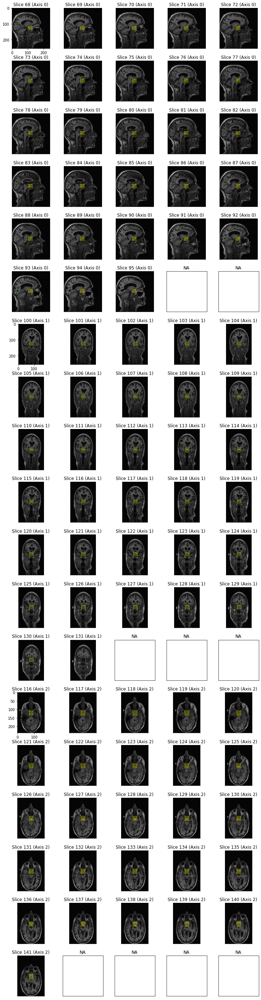

Count 1.
mr /sample_other_dsets/AIBL/80/MPRAGE_ADNI_confirmed/2010-09-24_12_23_33.0/S104499/corrected_n4.nii
seg AIBL_2-263/80
****************************************************************************************************


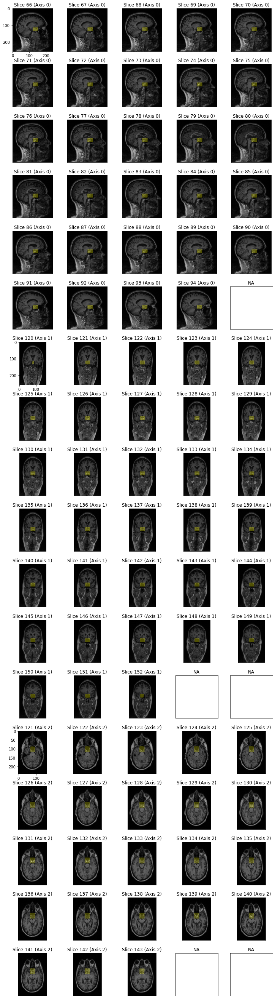

Count 2.
mr /sample_other_dsets/AIBL/97/MPRAGE_ADNI_confirmed/2010-04-23_11_07_35.0/S104530/corrected_n4.nii
seg AIBL_2-263/97
****************************************************************************************************


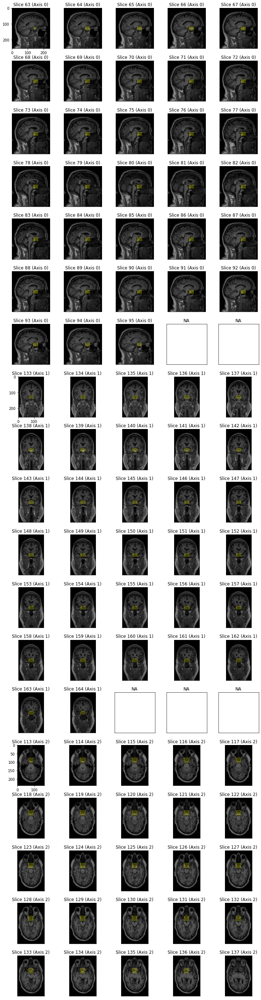

Count 3.
mr /sample_other_dsets/AIBL/126/MPRAGE_ADNI_confirmed/2014-02-13_11_40_30.0/S760500/corrected_n4.nii
seg AIBL_2-263/126
****************************************************************************************************


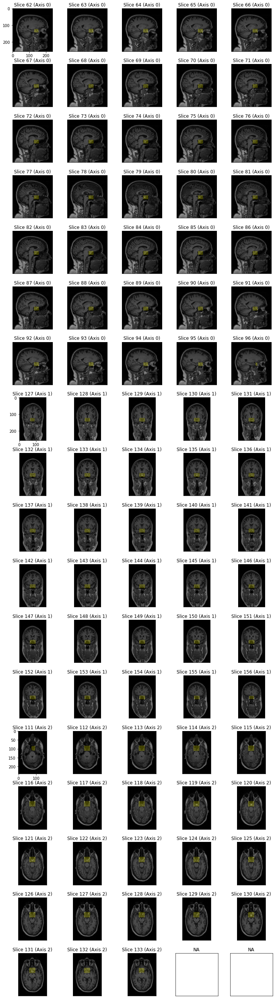

Count 4.
mr /sample_other_dsets/AIBL/17/MPRAGE_ADNI_confirmed/2011-01-28_12_56_23.0/S113471/corrected_n4.nii
seg AIBL_2-263/17
****************************************************************************************************


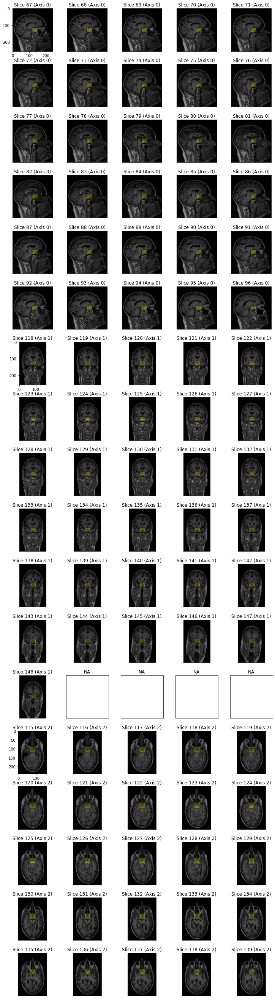

Count 5.
mr /sample_other_dsets/AIBL/2/MPRAGE_ADNI_confirmed/2011-11-15_10_42_23.0/S235328/corrected_n4.nii
seg AIBL_2-263/2
****************************************************************************************************


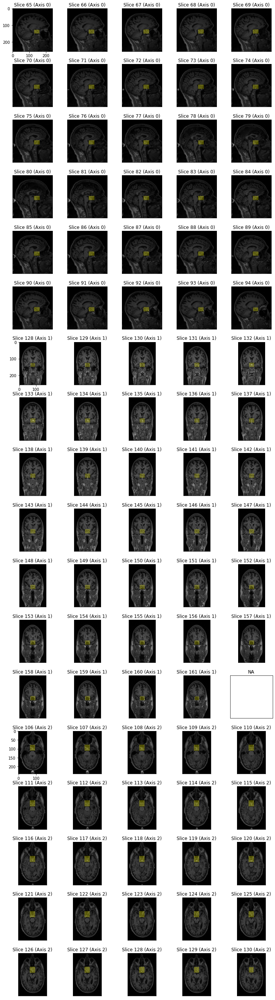

Count 6.
mr /sample_other_dsets/AIBL/104/MPRAGE_ADNI_confirmed/2010-05-07_12_06_54.0/S104522/corrected_n4.nii
seg AIBL_2-263/104
****************************************************************************************************


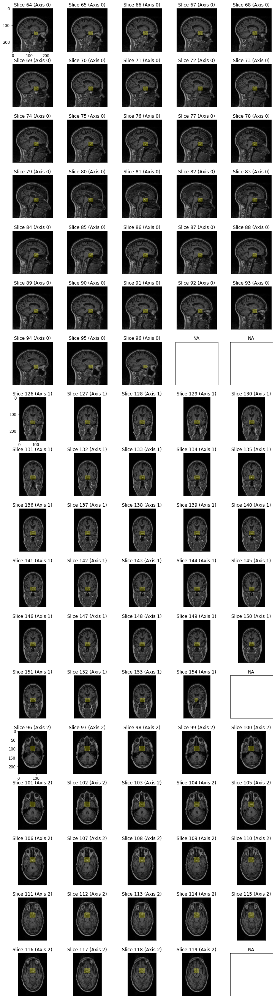

Count 7.
mr /sample_other_dsets/AIBL/99/MPRAGE_ADNI_confirmed/2007-10-08_14_59_18.0/S61715/corrected_n4.nii
seg AIBL_2-263/99
****************************************************************************************************


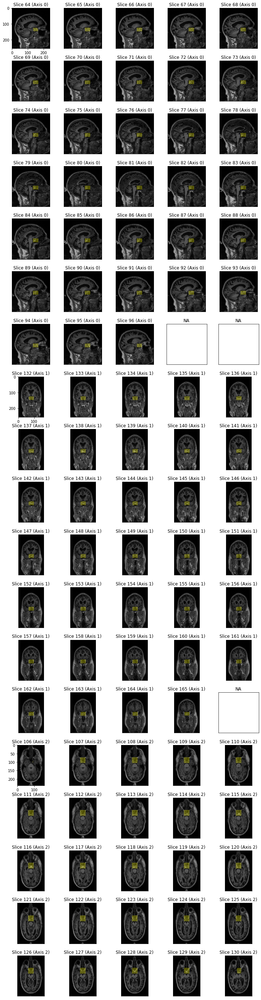

Count 8.
mr /sample_other_dsets/AIBL/259/MPRAGE_ADNI_confirmed/2009-08-20_08_18_54.0/S90705/corrected_n4.nii
seg AIBL_2-263/259
****************************************************************************************************


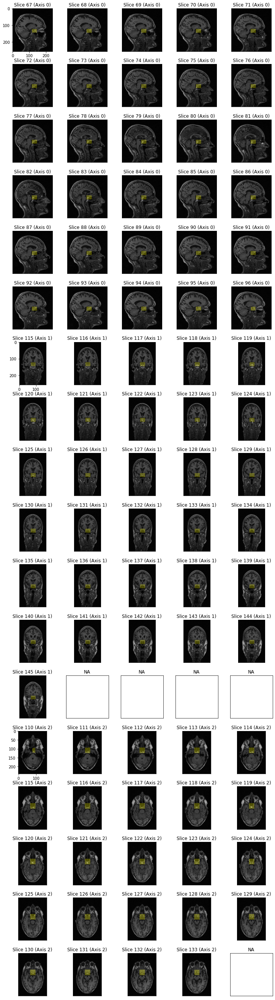

Count 9.
mr /sample_other_dsets/AIBL/64/MPRAGE_ADNI_confirmed/2011-05-20_11_18_18.0/S121238/corrected_n4.nii
seg AIBL_2-263/64
****************************************************************************************************


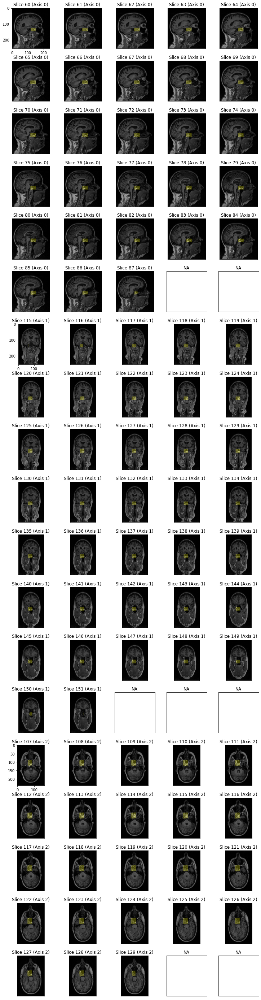

In [46]:
for i in range(0,10): viz_arr(i)

# Viz 10-20

Count 10.
mr /sample_other_dsets/AIBL/38/MPRAGE_ADNI_confirmed/2013-07-19_10_47_31.0/S782832/corrected_n4.nii
seg AIBL_2-263/38
****************************************************************************************************


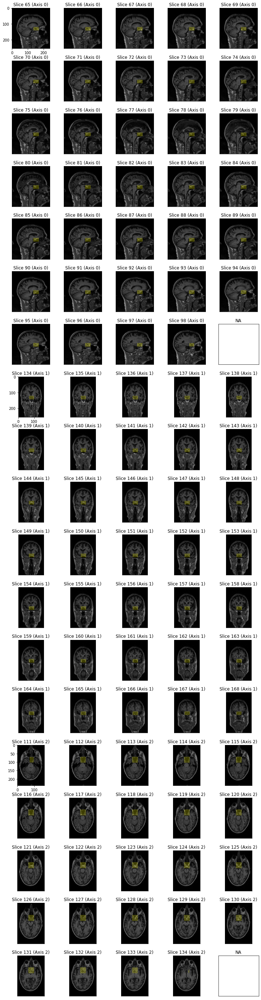

Count 11.
mr /sample_other_dsets/AIBL/206/MPRAGE_ADNI_confirmed/2011-03-19_16_12_28.0/S118769/corrected_n4.nii
seg AIBL_2-263/206
****************************************************************************************************


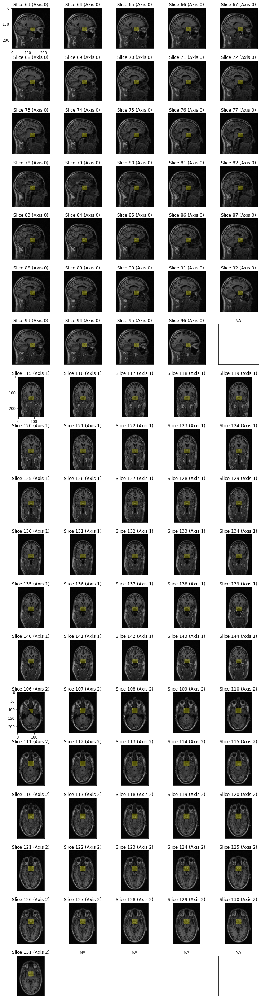

Count 12.
mr /sample_other_dsets/AIBL/22/MPRAGE_ADNI_confirmed/2010-08-25_12_31_50.0/S104466/corrected_n4.nii
seg AIBL_2-263/22
****************************************************************************************************


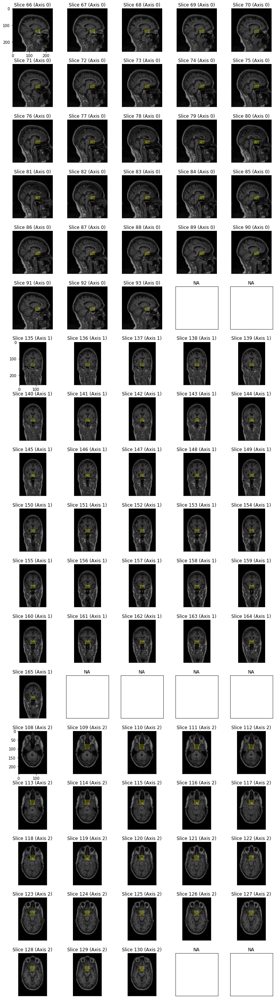

Count 13.
mr /sample_other_dsets/AIBL/244/MPRAGE_ADNI_confirmed/2013-05-25_10_08_56.0/S248231/corrected_n4.nii
seg AIBL_2-263/244
****************************************************************************************************


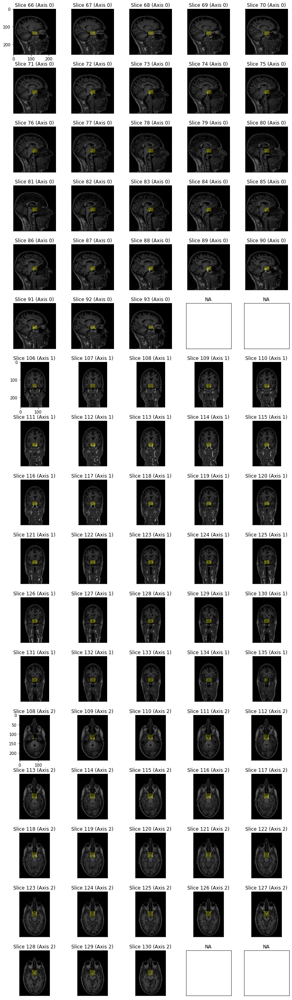

Count 14.
mr /sample_other_dsets/AIBL/20/MPRAGE_ADNI_confirmed/2007-11-05_15_15_13.0/S63515/corrected_n4.nii
seg AIBL_2-263/20
****************************************************************************************************


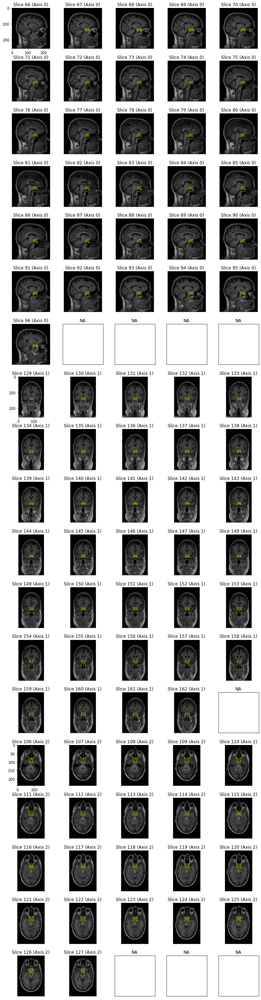

Count 15.
mr /sample_other_dsets/AIBL/118/MPRAGE_ADNI_confirmed/2010-08-04_14_26_39.0/S104520/corrected_n4.nii
seg AIBL_2-263/118
****************************************************************************************************


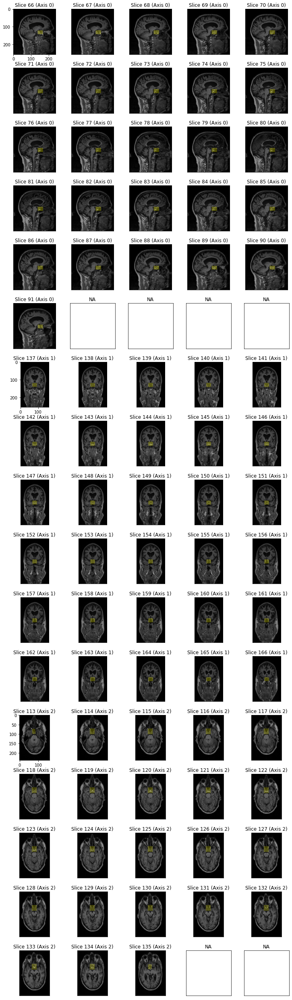

Count 16.
mr /sample_other_dsets/AIBL/156/MPRAGE_ADNI_confirmed/2008-04-21_15_15_03.0/S64485/corrected_n4.nii
seg AIBL_2-263/156
****************************************************************************************************


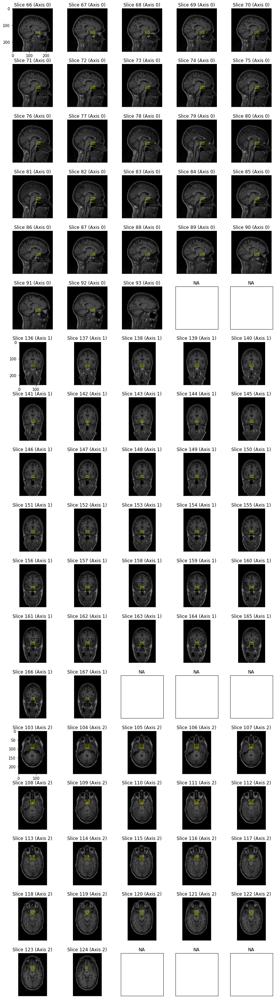

Count 17.
mr /sample_other_dsets/AIBL/42/MPRAGE_ADNI_confirmed/2007-10-12_10_06_08.0/S63502/corrected_n4.nii
seg AIBL_2-263/42
****************************************************************************************************


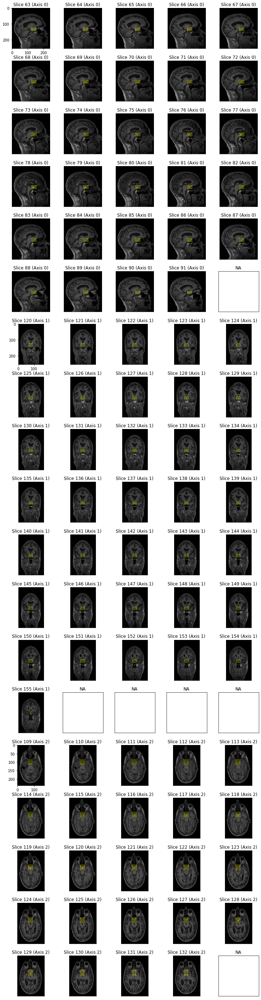

Count 18.
mr /sample_other_dsets/AIBL/186/MPRAGE_ADNI_confirmed/2008-05-02_09_22_15.0/S82475/corrected_n4.nii
seg AIBL_2-263/186
****************************************************************************************************


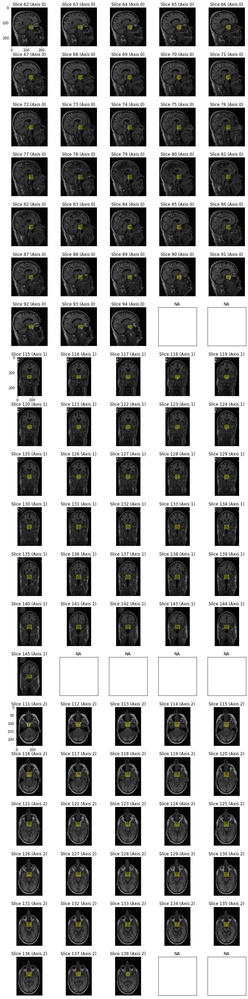

Count 19.
mr /sample_other_dsets/AIBL/207/MPRAGE_ADNI_confirmed/2008-03-14_07_17_47.0/S82620/corrected_n4.nii
seg AIBL_2-263/207
****************************************************************************************************


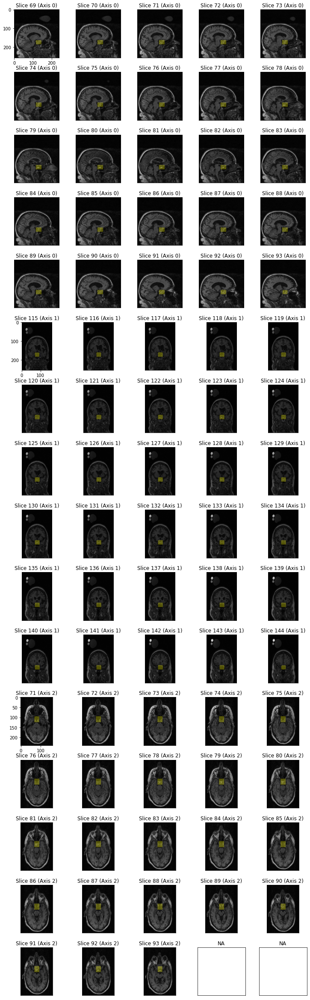

In [53]:
for i in range(10,20): viz_arr(i)

# Done

In [51]:
print("Done.")

Done.


In [52]:
from nbconvert import HTMLExporter
import codecs
import nbformat

notebook_name = '04a_save_seg_masks.ipynb'
output_file_name = 'new_segs_output.html'

exporter = HTMLExporter()
output_notebook = nbformat.read(notebook_name, as_version=4)

output, resources = exporter.from_notebook_node(output_notebook)
codecs.open(output_file_name, 'w', encoding='utf-8').write(output)

In [ ]:
# count = 0
# for mr_path, seg_path in items:
    
#     # fname to save
#     fn = str(Path(seg_path).parent)
    
#     # save PyTorch segmentation arr
#     seg_arr = get_segm_arr((mr_path, seg_path))
    
#     torch.save(seg_arr, fn+"/seg.pt")
    
#     # save num elem in segm mask
#     # num_in_mask = torch.count_nonzero(seg_arr)
#     # torch.save(num_in_mask, fn+"/num_seg.pt")
    
#     # print
#     print("index ", count, "fn ", fn)
#     # print("index ", count, "fn ", fn, "num ", num_in_mask)
#     count += 1